<a href="https://colab.research.google.com/github/AdBharat14/Data-Mining-Project/blob/main/complete_project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#### importing libraries

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import math
from sklearn.preprocessing import LabelEncoder
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import Normalizer
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from imblearn.over_sampling import RandomOverSampler
from imblearn.over_sampling import SMOTE
from sklearn.naive_bayes import GaussianNB
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import f1_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import recall_score
from sklearn.metrics import precision_score
import random
from sklearn.model_selection import StratifiedKFold
from google.colab import drive
seed=29

# 3 Data description

In [ ]:
df = pd.read_csv("aug_train.csv")

In [ ]:
df.head(5)

,enrollee_id,city,city_development_index,gender,relevent_experience,enrolled_university,education_level,major_discipline,experience,company_size,company_type,last_new_job,training_hours,target
0,8949,city_103,0.920,Male,Has relevent experience,no_enrollment,Graduate,STEM,>20,NaN,NaN,1,36,1.0
1,29725,city_40,0.776,Male,No relevent experience,no_enrollment,Graduate,STEM,15,50-99,Pvt Ltd,>4,47,0.0
2,11561,city_21,0.624,NaN,No relevent experience,Full time course,Graduate,STEM,5,NaN,NaN,never,83,0.0
3,33241,city_115,0.789,NaN,No relevent experience,NaN,Graduate,Business Degree,<1,NaN,Pvt Ltd,never,52,1.0
4,666,city_162,0.767,Male,Has relevent experience,no_enrollment,Masters,STEM,>20,50-99,Funded Startup,4,8,0.0


Changing type of target value to int

In [ ]:
df["target"] = df["target"].astype(np.int64)

Function to describe data for each column

In [ ]:
coulmn_names = df.columns
def desc(ser):
    print(f'{ser.name} : {ser.dtype}')
    print(f'null values: {ser.isna().sum()}')
    print(ser.describe())
    print()


### 3.1 Function description

In [ ]:
for i in coulmn_names:
    desc(df[i])

enrollee_id : int64
null values: 0
count    19158.000000
mean     16875.358179
std       9616.292592
min          1.000000
25%       8554.250000
50%      16982.500000
75%      25169.750000
max      33380.000000
Name: enrollee_id, dtype: float64

city : object
null values: 0
count        19158
unique         123
top       city_103
freq          4355
Name: city, dtype: object

city_development_index : float64
null values: 0
count    19158.000000
mean         0.828848
std          0.123362
min          0.448000
25%          0.740000
50%          0.903000
75%          0.920000
max          0.949000
Name: city_development_index, dtype: float64

gender : object
null values: 4508
count     14650
unique        3
top        Male
freq      13221
Name: gender, dtype: object

relevent_experience : object
null values: 0
count                       19158
unique                          2
top       Has relevent experience
freq                        13792
Name: relevent_experience, dtype: object

enr

### 3.2 Null Values

<AxesSubplot:title={'center':'plot of null values'}>

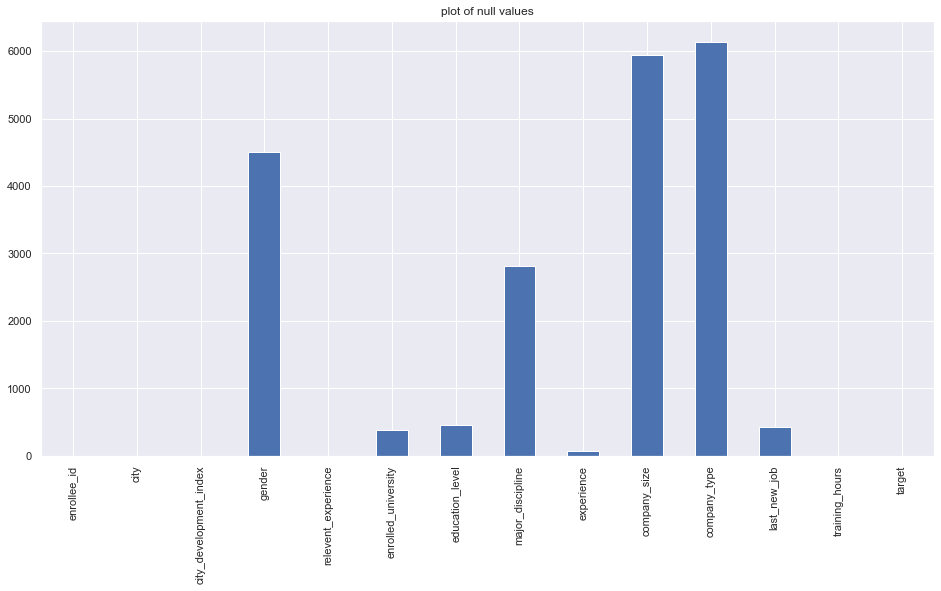

In [ ]:
nulls = df.isna().sum()
nulls.plot.bar(figsize=(16,8),title="plot of null values")

### 3.3 Plotting Data

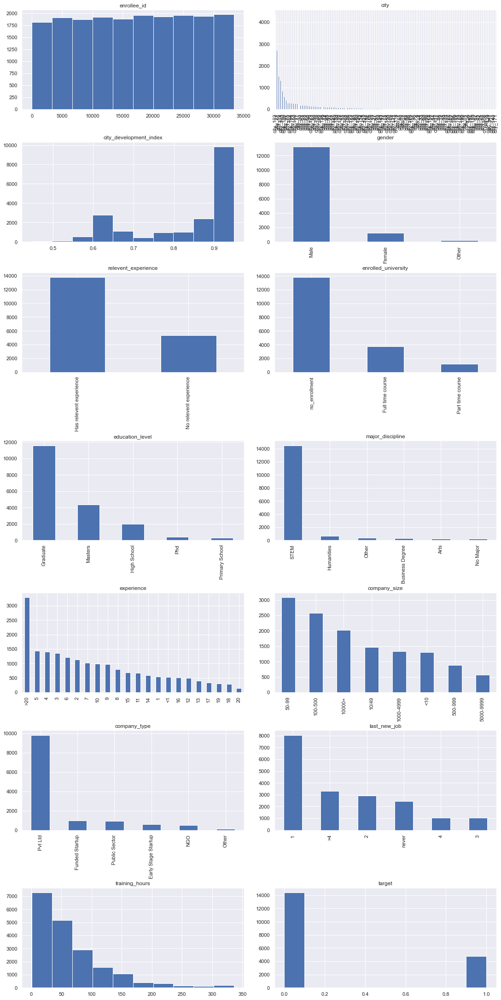

In [ ]:
fig, ax = plt.subplots(7, 2, constrained_layout=True)
columns = df.columns
for i in range(7):
    for j in range(2):
        if df[columns[i*2+j]].dtype == np.int64 or df[columns[i*2+j]].dtype == np.float64:
            df[columns[i*2+j]].hist(ax=ax[i,j])
        else:
            df[columns[i*2+j]].value_counts().plot(kind='bar',ax=ax[i,j])
        ax[i,j].title.set_text(columns[i*2+j])
fig.set_figwidth(15)
fig.set_figheight(30)

<AxesSubplot:>

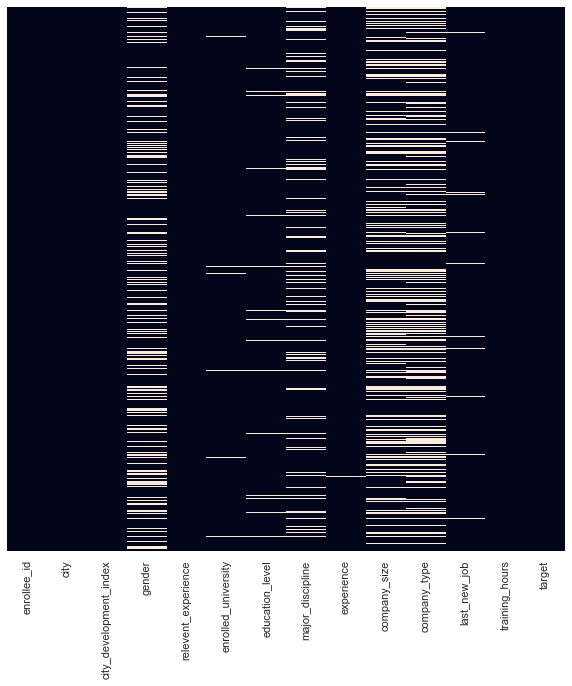

In [ ]:
import seaborn as sb
fig, ax = plt.subplots(figsize=(10,10))
sb.heatmap(df.isna(),yticklabels=False,cbar=False,ax=ax)

<AxesSubplot:>

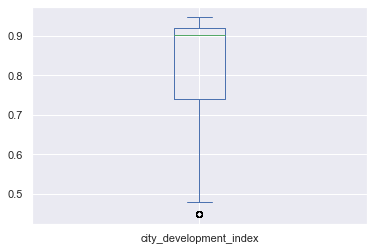

In [ ]:
df['city_development_index'].plot(kind='box')

<AxesSubplot:>

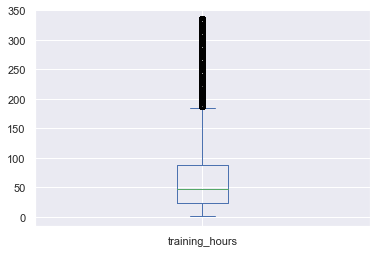

In [ ]:
df['training_hours'].plot(kind='box')

## 3.4 Handling outliers

In [ ]:
def remove_outliers(df, field):
    Q1 = df[field].quantile(0.25)
    Q2 = df[field].quantile(0.75)
    IQR = Q2-Q1
    whisker_width = 1.5
    lower_whisker = Q1 - whisker_width*IQR
    upper_whisker = Q2 + whisker_width*IQR
    df[field] = np.where(df[field]>upper_whisker, upper_whisker, np.where(df[field]<lower_whisker, lower_whisker,df[field]))

In [ ]:
remove_outliers(df,'training_hours')

In [ ]:
remove_outliers(df, 'city_development_index')

<AxesSubplot:>

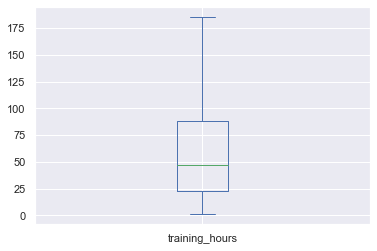

In [ ]:
df['training_hours'].plot(kind='box')

<AxesSubplot:>

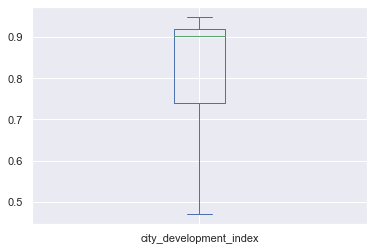

In [ ]:
df['city_development_index'].plot(kind='box')

# **4** Data Preprocessing

## **4.1** Handling null values
Null/NaN values are the missing data which have not been recorded due to some anomaly. Raw data containing null values is like an incomplete dataset. Applying data mining methods wouldn’t yield anything feasible. So in preprocessing the first step taken is to handle the missing values. There are many ways to handle the missing data. Few of them are:

* ### Deleting the null values
It is the simplest way to deal with null values. In this the rows containing null values are deleted. This approach works with a large dataset containing a few null values so the dataset is not affected. On deleting null values from small datasets it creates shortage of data to train and test. So it isn’t a good way of handling data in the dataset used on this project.

* ### Taking mean/mode
Taking mean and mode is one of the simplest, easiest and most common way to fill null values in dataset with large null values. By taking mean it can be ensured that mean of the values doesnt deviate. But it can't be used on categorical attributes so mode is used to handle the values in these attriutes. By taking mode we can assign the most occuring class to an attribute.

* ### Imputing the null values
Imputation is like a prediction of the null values based on the data we already have. We use the fact that all the theoretical independent attribute are somewhat dependent on each other and discover the trends in data using different model and use the knowledge to predict the missing the null values.

* ### Iterative imputation
Iterative imputation is taking imputing null values to next step. In this the null values are predicted again and again for each column until a number of given iteration passes or there is no significant change in values being imputed.

## **4.2**  Feature Scaling

Feature scaling is essential for machine learning algorithms that calculate distances between data. If not scale, the feature with a higher value range starts dominating when calculating distances. Types of feature scaling:

* **Min-Max Scaling:**</br>
<font size=5><center>$x_{new} = \frac{x-x_{min}}{x_{max}-x_{min}}$</font></center></br>
    Transform features by scaling each feature to a given range. This estimator scales and translates each feature individually such that it is in the given range on the training set, e.g., between zero and one. This Scaler shrinks the data within the range of -1 to 1 if there are negative values. Ranges can be set like [0,1] or [0,5] or [-1,1].

* **Standardization:**</br>
<font size=5><center>$x_{new} = \frac{x-\mu}{\sigma}$</font></center></br>
    The Standard Scaler assumes data is normally distributed within each feature and scales them such that the distribution centered around 0, with a standard deviation of 1. Centering and scaling happen independently on each feature by computing the relevant statistics on the samples in the training set. If data is not normally distributed, this is not the best Scaler to use.

* **Normalization:**</br>
    A special case of min-max scaling where the ouput generated is always in range [0,1].

## **4.3**	FEATURE SELECTION AND CONVERSION

Feature selection and conversion is an important part of the data preprocessing. It helps in the removal of the redundant features and tranform the features so it suits the models better.

<a href = 'https://towardsdatascience.com/all-about-feature-scaling-bcc0ad75cb35#:~:text=Feature%20scaling%20is%20essential%20for,the%20%E2%80%9Cwhy%3F%E2%80%9D%20section.'>references</a>


In [ ]:
print(f'total number of null values: {df.isna().sum().sum()}')

total number of null values: 20733


<font size="5" color="green">Visualising null values corelation with each other</font>
<p><font size="4">visualising null values is also important because it can help us find relation between null values of different column and process the data accordingly.</p> <p><u>missingno</u> and <u>seaborn</u> library makes it easier to find corelation between missig data in column and visualize it</font></p>

<font size="3">missingno's corelation heatmap plot of null values:</font>

<AxesSubplot:>

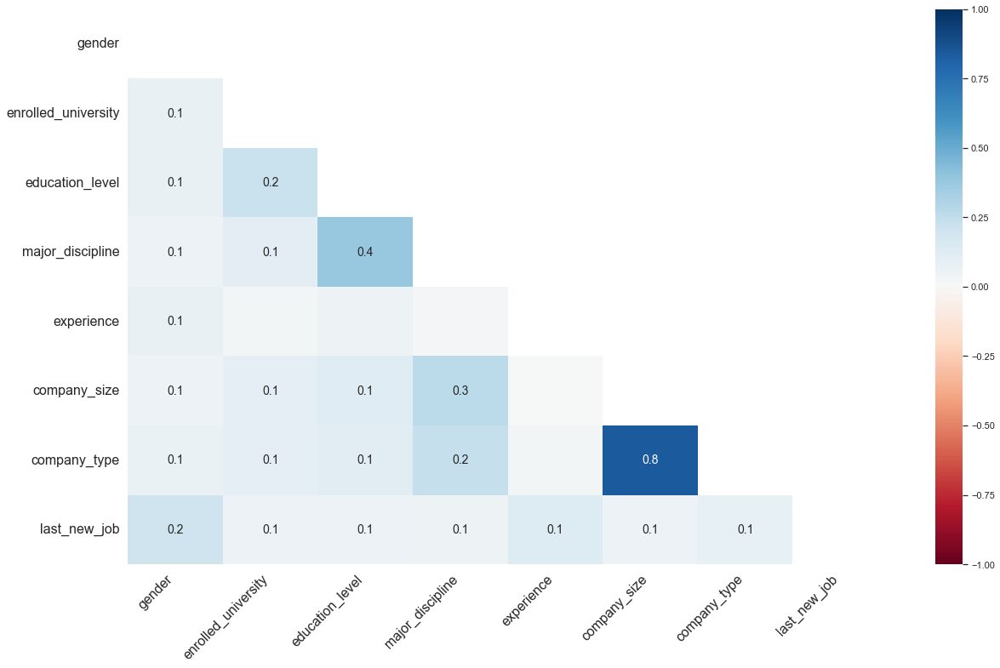

In [ ]:
import missingno as msno
msno.heatmap(df)

<AxesSubplot:>

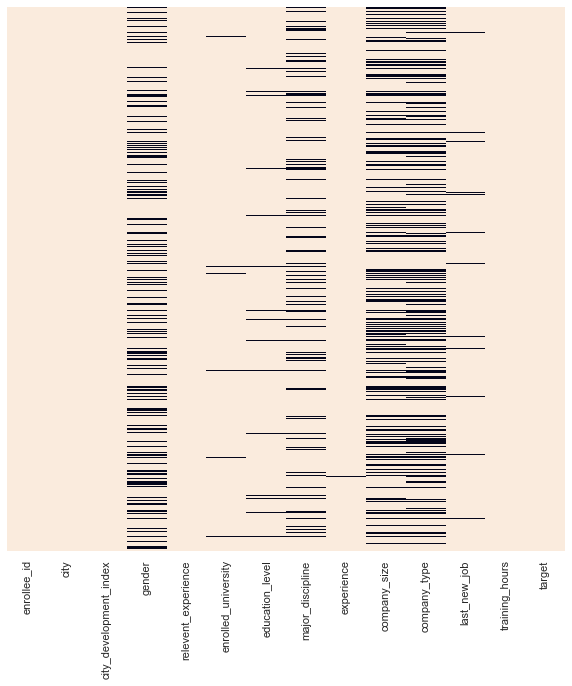

In [ ]:
fig, ax = plt.subplots(figsize=(10,10))
sns.heatmap(~df.isna(),yticklabels=False,cbar=False,ax=ax)

*company_size and company_type null values have high corelation*

In [ ]:
df.isna().sum()

enrollee_id                  0
city                         0
city_development_index       0
gender                    4508
relevent_experience          0
enrolled_university        386
education_level            460
major_discipline          2813
experience                  65
company_size              5938
company_type              6140
last_new_job               423
training_hours               0
target                       0
dtype: int64

Attributes containing null values:
gender:                         4508

enrolled_university: 386

education_level:            460

major_discipline:          2813

experience:                  65

company_size:              5938

company_type:              6140

last_new_job:               423

In [ ]:
#calculating null values
def null_values(df,column_name):
    nulls = df[column_name].isna().sum()
    null_percentage = nulls*100/df.shape[0]
    print(f"No. of nulls = {nulls}\nPercentage: {null_percentage}")

def plot_uniques(df,column_name):
    sns.catplot(x=column_name, kind="count", data=df, hue="target", height=7, aspect=10/5)

In [ ]:
to_remove=[]
from scipy.sparse import csr_matrix
def binary_encoding(column,ind):
    global df,to_remove
    ct = ColumnTransformer(transformers=[('encoder', OneHotEncoder(), [ind])],remainder = "drop")
    arr = ct.fit_transform(df)
    if isinstance(arr,csr_matrix):
        arr = arr.toarray()
    arr = np.array(list(map(lambda x: x[:-1],arr)))
    names = ct.get_feature_names()
    names = list(map(lambda x: column + '_' + x.split('_')[-1],names))
    temp_df = pd.DataFrame(data=arr,columns=names[:-1])
    to_remove.append(column)
    df = pd.concat([df,temp_df],axis=1)

<font size="5" color="green">enrollee_id</font>
<p>Column with enrollee id doesnt contribute to the data prediction and modelling so it should be removed</p>

In [ ]:
to_remove.append('enrollee_id')

<font size="5" color="green">city</font>

In [ ]:
df['city'].unique()

array(['city_103', 'city_40', 'city_21', 'city_115', 'city_162',
       'city_176', 'city_160', 'city_46', 'city_61', 'city_114',
       'city_13', 'city_159', 'city_102', 'city_67', 'city_100',
       'city_16', 'city_71', 'city_104', 'city_64', 'city_101', 'city_83',
       'city_105', 'city_73', 'city_75', 'city_41', 'city_11', 'city_93',
       'city_90', 'city_36', 'city_20', 'city_57', 'city_152', 'city_19',
       'city_65', 'city_74', 'city_173', 'city_136', 'city_98', 'city_97',
       'city_50', 'city_138', 'city_82', 'city_157', 'city_89',
       'city_150', 'city_70', 'city_175', 'city_94', 'city_28', 'city_59',
       'city_165', 'city_145', 'city_142', 'city_26', 'city_12',
       'city_37', 'city_43', 'city_116', 'city_23', 'city_99', 'city_149',
       'city_10', 'city_45', 'city_80', 'city_128', 'city_158',
       'city_123', 'city_7', 'city_72', 'city_106', 'city_143', 'city_78',
       'city_109', 'city_24', 'city_134', 'city_48', 'city_144',
       'city_91', 'city_

as shown in unique values the city number *city_* should be removed for getting a numerical data.

In [ ]:
df['city'] = df['city'].apply(lambda x: int(x.replace('city_','')))

In [ ]:
df['city']

0        103
1         40
2         21
3        115
4        162
5        176
6        160
7         46
8        103
9        103
10        21
11       103
12        61
13        21
14        21
15       114
16       103
17        21
18        21
19        13
20       159
21       114
22       102
23        40
24        21
25        67
26        21
27       103
28       100
29        21
30       103
31       103
32       103
33       160
34        16
35       103
36       114
37       114
38       103
39        71
40       114
41       104
42        21
43        64
44        21
45        21
46        21
47       103
48       101
49        83
50       101
51        64
52       105
53       104
54       114
55       104
56        73
57       103
58        21
59       162
60        67
61        75
62        41
63       100
64        11
65        93
66        67
67        16
68        16
69        90
70        64
71        21
72        13
73        67
74        11
75       103
76        36

<font size="5" color="green">city_development_index</font>

In [ ]:
df["city_development_index"].describe()

count    19158.000000
mean         0.828868
std          0.123303
min          0.470000
25%          0.740000
50%          0.903000
75%          0.920000
max          0.949000
Name: city_development_index, dtype: float64

city_development_index cn be left as it is. Its already a normalized data.

<font size="5" color="green">gender</font>

In [ ]:
null_values(df,'gender')

No. of nulls = 4508
Percentage: 23.530639941538784


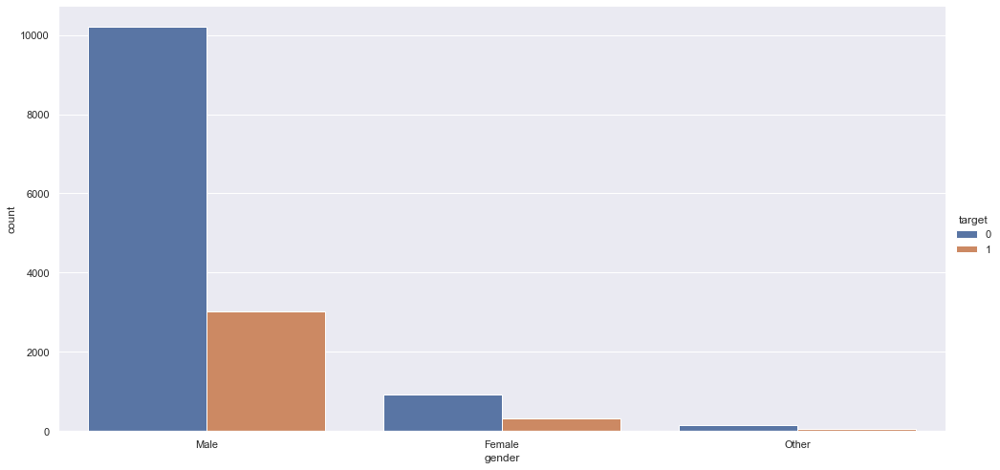

In [ ]:
plot_uniques(df,'gender')

In [ ]:
df['gender'].unique()

array(['Male', nan, 'Female', 'Other'], dtype=object)

In [ ]:
df['gender'] = df['gender'].replace(np.nan,df['gender'].mode()[0])

In [ ]:
df['gender'].unique()

array(['Male', 'Female', 'Other'], dtype=object)

In [ ]:
df['gender'] = le.fit_transform(df['gender'])

In [ ]:
binary_encoding('gender',3)

<font size="5" color="green">relevent_experience</font>

In [ ]:
df['relevent_experience'] = le.fit_transform(df['relevent_experience'])

In [ ]:
df['relevent_experience'].unique()

array([0, 1])

<font size="5" color="green">enrolled_university</font>

In [ ]:
null_values(df,'enrolled_university')

No. of nulls = 386
Percentage: 2.014824094373108


In [ ]:
df['enrolled_university'].unique()

array(['no_enrollment', 'Full time course', nan, 'Part time course'],
      dtype=object)

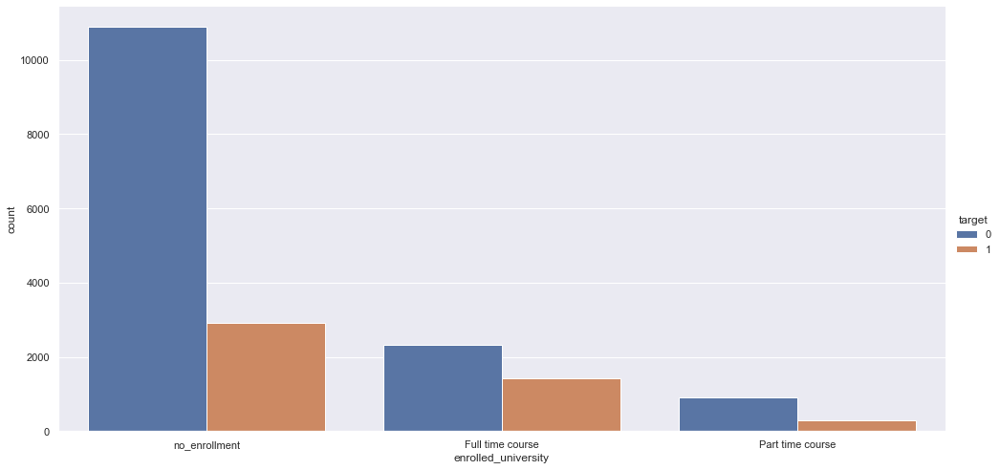

In [ ]:
plot_uniques(df,'enrolled_university')

*enrolled_university is a column with categorical and approx 300 null values(2% of rows). So the null data can be replaced by the mode of the values present in enrolled_university.*

In [ ]:
df['enrolled_university'] = df['enrolled_university'].fillna(df['enrolled_university'].mode()[0])

In [ ]:
df['enrolled_university'].unique()

array(['no_enrollment', 'Full time course', 'Part time course'],
      dtype=object)

In [ ]:
df['enrolled_university'] = le.fit_transform(df['enrolled_university'])

In [ ]:
df['enrolled_university'].unique()

array([2, 0, 1])

In [ ]:
binary_encoding('enrolled_university',5)

<font color = "green" size=5>education_level</font>

In [ ]:
null_values(df,'education_level')

No. of nulls = 460
Percentage: 2.401085708320284


In [ ]:
df['education_level'].unique()

array(['Graduate', 'Masters', 'High School', nan, 'Phd', 'Primary School'],
      dtype=object)

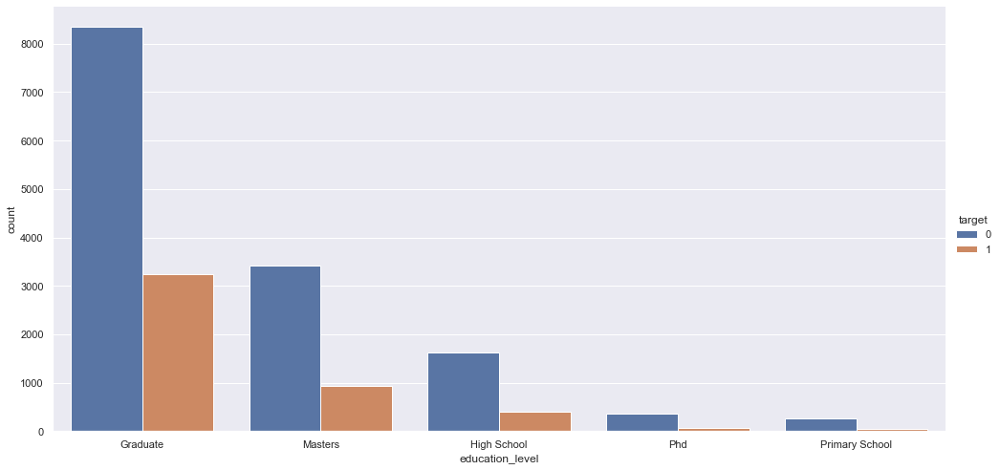

In [ ]:
plot_uniques(df,'education_level')

<font size=4><i>The number of null values are too less so for categorical data it can be replaced by mode</i></font>

In [ ]:
df['education_level'] = df['education_level'].fillna(df['education_level'].mode()[0])

In [ ]:
df['education_level'].unique()

array(['Graduate', 'Masters', 'High School', 'Phd', 'Primary School'],
      dtype=object)

In [ ]:
education_level_dict = {'Graduate':2, 'Masters':3, 'High School':1, 'Phd':4, 'Primary School':0}
df['education_level'] = df['education_level'].map(education_level_dict)

In [ ]:
df['education_level'].unique()

array([2, 3, 1, 4, 0], dtype=int64)

In [ ]:
from sklearn.preprocessing import MinMaxScaler
mms = MinMaxScaler()
df['education_level'] = mms.fit_transform(df['education_level'].values.reshape(-1,1)).reshape(19158,)
df['education_level'].unique()

array([0.5 , 0.75, 0.25, 1.  , 0.  ])

<font size=5 color='green'>major_discipline</font>

By observing the data it can be found that there is a relation between major_discipline and education_level attribute

In [ ]:
null_values(df,'major_discipline')

No. of nulls = 2813
Percentage: 14.68316108153252


In [ ]:
c,d = df['education_level'],df['major_discipline']

In [ ]:
c = c.replace([0, 0.25],np.nan)

<AxesSubplot:>

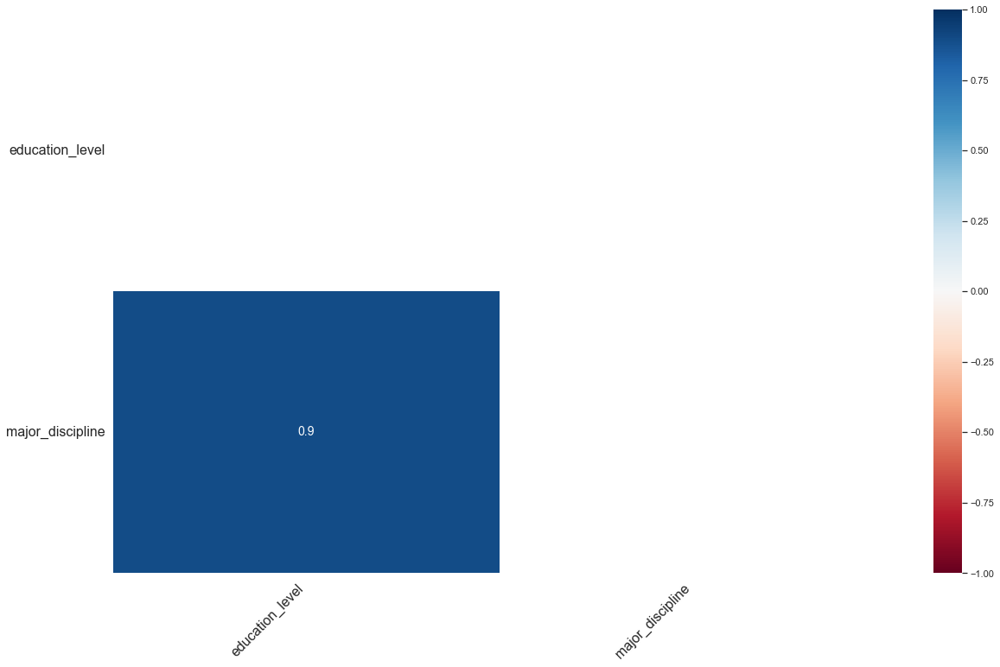

In [ ]:
msno.heatmap(pd.concat((c,d),axis=1))

<font size=4><i>As depicted by the heatmap it is evident that the 90% of major_discipline empty value coincides with education_level of education</i></font>

In [ ]:
def checker(x):
    if (x['education_level'] in [0,0.25] and math.isnan(x['major_discipline'])):
        return 'No Major'
    else:
        return x['major_discipline']
df['major_discipline'] = df.apply(checker,axis=1)

In [ ]:
null_values(df,'major_discipline')

No. of nulls = 488
Percentage: 2.5472387514354318


<font size=4><i>Remaining null values are too low so they can be replaced by mode</i></font>

In [ ]:
df['major_discipline'].value_counts()

STEM               14492
No Major            2548
Humanities           669
Other                381
Business Degree      327
Arts                 253
Name: major_discipline, dtype: int64

In [ ]:
df['major_discipline'] = df['major_discipline'].fillna(df['major_discipline'].mode().values[0])

In [ ]:
df['major_discipline'].unique()

array(['STEM', 'Business Degree', 'No Major', 'Arts', 'Humanities',
       'Other'], dtype=object)

In [ ]:
df['major_discipline'] = le.fit_transform(df['major_discipline'])
df['major_discipline'].unique()

array([5, 1, 3, 0, 2, 4])

In [ ]:
binary_encoding('major_discipline',7)

<font size=5 color="green">experience</font>

In [ ]:
null_values(df,'experience')

No. of nulls = 65
Percentage: 0.3392838500887358


In [ ]:
df['experience'].unique()

array(['>20', '15', '5', '<1', '11', '13', '7', '17', '2', '16', '1', '4',
       '10', '14', '18', '19', '12', '3', '6', '9', '8', '20', nan],
      dtype=object)

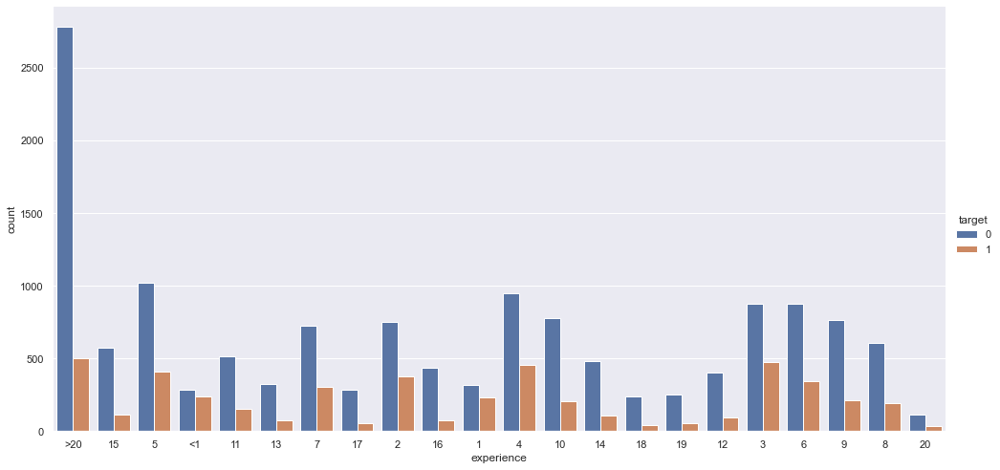

In [ ]:
plot_uniques(df,'experience')

*As seen by the number of null values and being a categorical attribute it can be replaced by mode too*

In [ ]:
df['experience']= df['experience'].fillna(value = df['experience'].mode().values[0])

In [ ]:
df['experience'].unique()

array(['>20', '15', '5', '<1', '11', '13', '7', '17', '2', '16', '1', '4',
       '10', '14', '18', '19', '12', '3', '6', '9', '8', '20'],
      dtype=object)

In [ ]:
df['experience'] = df['experience'].replace('>20','21')
df['experience'] = df['experience'].replace('<1','0')
df['experience'].unique()

array(['21', '15', '5', '0', '11', '13', '7', '17', '2', '16', '1', '4',
       '10', '14', '18', '19', '12', '3', '6', '9', '8', '20'],
      dtype=object)

In [ ]:
df["experience"] = df["experience"].astype(int)

In [ ]:
mms = MinMaxScaler()
df['experience'] = mms.fit_transform(df['experience'].values.reshape(-1,1)).reshape(19158,)
df['experience'].unique()

array([1.        , 0.71428571, 0.23809524, 0.        , 0.52380952,
       0.61904762, 0.33333333, 0.80952381, 0.0952381 , 0.76190476,
       0.04761905, 0.19047619, 0.47619048, 0.66666667, 0.85714286,
       0.9047619 , 0.57142857, 0.14285714, 0.28571429, 0.42857143,
       0.38095238, 0.95238095])

<font size=5 color="green">last_new_job</font>

In [ ]:
null_values(df,'last_new_job')

No. of nulls = 423
Percentage: 2.207954901346696


In [ ]:
df['last_new_job'].unique()

array(['1', '>4', 'never', '4', '3', '2', nan], dtype=object)

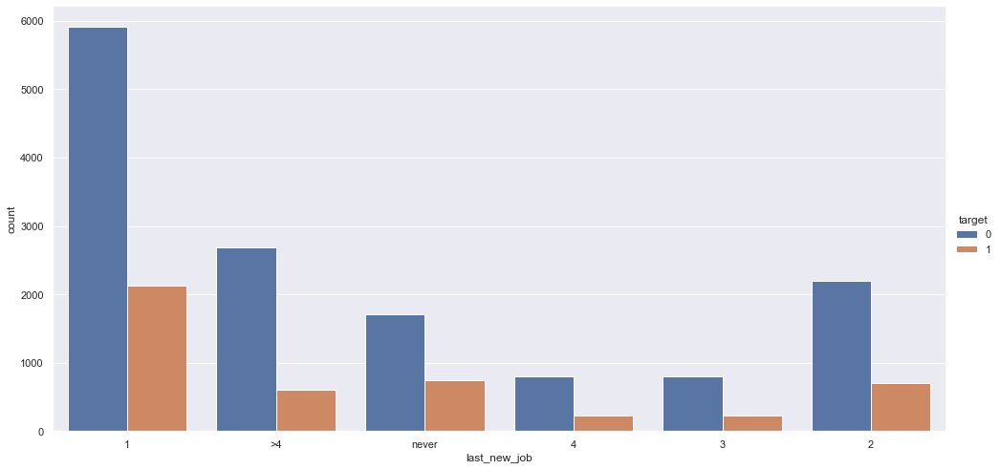

In [ ]:
plot_uniques(df,'last_new_job')

*last_new_job also has a low percentage of null values so it can also be replaced by mode*

In [ ]:
df['last_new_job'] = df['last_new_job'].replace(np.nan,df['last_new_job'].mode().values[0])

In [ ]:
df['last_new_job'].unique()

array(['1', '>4', 'never', '4', '3', '2'], dtype=object)

In [ ]:
df['last_new_job'] = df['last_new_job'].replace('>4',5)
df['last_new_job'] = df['last_new_job'].replace('never',0)

In [ ]:
df['last_new_job'] = df['last_new_job'].astype('int')

In [ ]:
mms = MinMaxScaler()
df['last_new_job'] = mms.fit_transform(df['last_new_job'].values.reshape(-1,1)).reshape(19158,)
df['last_new_job'].unique()

array([0.2, 1. , 0. , 0.8, 0.6, 0.4])

<font size=5 color="green">company_type and company_size</font>

In [ ]:
null_values(df,"company_type")
null_values(df,"company_size")

No. of nulls = 6140
Percentage: 32.04927445453596
No. of nulls = 5938
Percentage: 30.99488464349097


<AxesSubplot:>

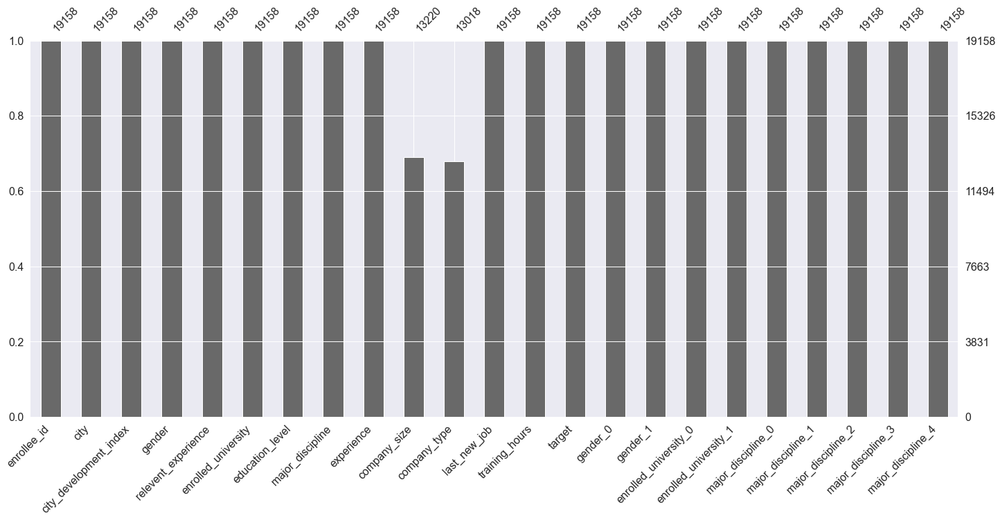

In [ ]:
msno.bar(df)

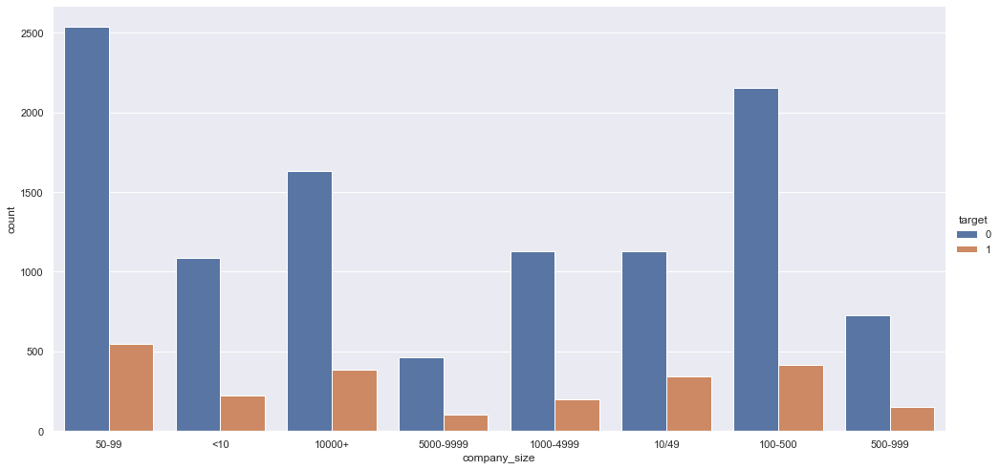

In [ ]:
plot_uniques(df,'company_size')

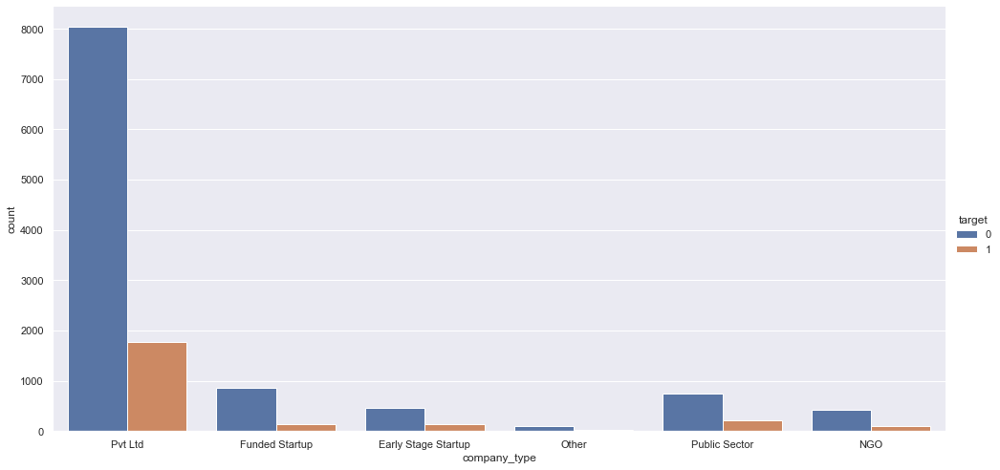

In [ ]:
plot_uniques(df,'company_type')

In [ ]:
df['company_type'].unique()

array([nan, 'Pvt Ltd', 'Funded Startup', 'Early Stage Startup', 'Other',
       'Public Sector', 'NGO'], dtype=object)

In [ ]:
# df['company_type'] = df['company_type'].fillna(df['company_type'].mode()[0])
# df['company_type'] = le.fit_transform(df['company_type'])
# binary_encoding('company_type',10)

In [ ]:
# df.drop(to_remove,axis=1,inplace=True)

In [ ]:
columns = df.columns.tolist()

In [ ]:
columns.remove('target')
columns.remove('company_size')
columns.append('company_size')
columns.append('target')
columns

['enrollee_id',
 'city',
 'city_development_index',
 'gender',
 'relevent_experience',
 'enrolled_university',
 'education_level',
 'major_discipline',
 'experience',
 'company_type',
 'last_new_job',
 'training_hours',
 'gender_0',
 'gender_1',
 'enrolled_university_0',
 'enrolled_university_1',
 'major_discipline_0',
 'major_discipline_1',
 'major_discipline_2',
 'major_discipline_3',
 'major_discipline_4',
 'company_size',
 'target']

In [ ]:
df = df.reindex(columns= columns)

In [ ]:
df.head()

,enrollee_id,city,city_development_index,gender,relevent_experience,enrolled_university,education_level,major_discipline,experience,company_type,...,gender_1,enrolled_university_0,enrolled_university_1,major_discipline_0,major_discipline_1,major_discipline_2,major_discipline_3,major_discipline_4,company_size,target
0,8949,103,0.920,1,0,2,0.50,5,1.000000,NaN,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,1
1,29725,40,0.776,1,1,2,0.50,5,0.714286,Pvt Ltd,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,50-99,0
2,11561,21,0.624,1,1,0,0.50,5,0.238095,NaN,...,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0
3,33241,115,0.789,1,1,2,0.50,1,0.000000,Pvt Ltd,...,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,NaN,1
4,666,162,0.767,1,0,2,0.75,5,1.000000,Funded Startup,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,50-99,0


In [ ]:
# df['company_size'] = df['company_size'].replace('10/49','10-49')

In [ ]:
# df['company_size'].unique()

In [ ]:
# def company_size_converter(x):
#     if isinstance(x,str):
#         if '+' in x:
#             return int(int(x[:-1])+int(x[:-1])*0.1)
#         elif '<' in x:
#             return (int(x[1:])-int(x[1:])*0.1)
#         elif '-' in x:
#             s = list(map(int, x.split('-')))
#             return int(sum(s)/len(s))
#         else:
#             return x
#     return x

In [ ]:
# df['company_size'] = df['company_size'].apply(company_size_converter)

In [ ]:
# df['company_size'].unique()

In [ ]:
# from sklearn.experimental import enable_iterative_imputer
# from sklearn.impute import IterativeImputer
# ii = IterativeImputer(random_state=seed, max_iter=20)
# X = df.iloc[:,:-1].values
# X = ii.fit_transform(X)

In [ ]:
# y = df.iloc[:,-1].values

In [ ]:
# df = pd.DataFrame(data=X,columns=columns[:-1])
# df[columns[-1]] = y

In [ ]:
# df.isna().sum()

In [ ]:
# mms = MinMaxScaler()
# df['company_size'] = mms.fit_transform(df['company_size'].values.reshape(-1,1)).reshape(19158,)
# df['company_size'].unique()

In [ ]:
df['company_type'].unique()

array([nan, 'Pvt Ltd', 'Funded Startup', 'Early Stage Startup', 'Other',
       'Public Sector', 'NGO'], dtype=object)

In [ ]:
df['company_type'].unique()

array([nan, 'Pvt Ltd', 'Funded Startup', 'Early Stage Startup', 'Other',
       'Public Sector', 'NGO'], dtype=object)

In [ ]:
df['company_size'].value_counts()

50-99        3083
100-500      2571
10000+       2019
10/49        1471
1000-4999    1328
<10          1308
500-999       877
5000-9999     563
Name: company_size, dtype: int64

In [ ]:
df['company_size'].unique()

array([nan, '50-99', '<10', '10000+', '5000-9999', '1000-4999', '10/49',
       '100-500', '500-999'], dtype=object)

In [ ]:
mode_comp_type = df['company_type'].mode()[0]
max_freq_mode = df[df['company_type']==mode_comp_type]['company_size'].value_counts().index[0]
def transformer(x):
    if (x['company_type'] != x['company_type'] and x['company_size']!=x['company_size']):
        return (mode_comp_type,max_freq_mode)
    else:
        return (x['company_type'],x['company_size'])
tf = df.apply(transformer,axis=1,result_type='expand')
df['company_type'] = tf[0]
df['company_size'] = tf[1]

In [ ]:
null_values(df,'company_size')

No. of nulls = 578
Percentage: 3.017016390019835


In [ ]:
null_values(df,'company_type')

No. of nulls = 780
Percentage: 4.071406201064829


In [ ]:
df['company_type'] = df['company_type'].fillna(df['company_type'].mode()[0])
df['company_size'] = df['company_size'].fillna(df['company_size'].mode()[0])

In [ ]:
df['company_type'].unique()

array(['Pvt Ltd', 'Funded Startup', 'Early Stage Startup', 'Other',
       'Public Sector', 'NGO'], dtype=object)

In [ ]:
df['company_size'].unique()

array(['50-99', '<10', '10000+', '5000-9999', '1000-4999', '10/49',
       '100-500', '500-999'], dtype=object)

In [ ]:
company_size_dict = {'50-99':2, '<10':0, '10000+':7, '5000-9999':6, '1000-4999':5, '10/49':1,'100-500':3, '500-999':4}
df['company_type'] = le.fit_transform(df['company_type'])
df['company_size'] = df['company_size'].map(company_size_dict)

In [ ]:
df

,enrollee_id,city,city_development_index,gender,relevent_experience,enrolled_university,education_level,major_discipline,experience,company_type,...,gender_1,enrolled_university_0,enrolled_university_1,major_discipline_0,major_discipline_1,major_discipline_2,major_discipline_3,major_discipline_4,company_size,target
0,8949,103,0.920,1,0,2,0.50,5,1.000000,5,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2,1
1,29725,40,0.776,1,1,2,0.50,5,0.714286,5,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2,0
2,11561,21,0.624,1,1,0,0.50,5,0.238095,5,...,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,2,0
3,33241,115,0.789,1,1,2,0.50,1,0.000000,5,...,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,2,1
4,666,162,0.767,1,0,2,0.75,5,1.000000,1,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2,0
5,21651,176,0.764,1,0,1,0.50,5,0.523810,5,...,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,2,1
6,28806,160,0.920,1,0,2,0.25,3,0.238095,1,...,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,2,0
7,402,46,0.762,1,0,2,0.50,5,0.619048,5,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,1
8,27107,103,0.920,1,0,2,0.50,5,0.333333,5,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2,1
9,699,103,0.920,1,0,2,0.50,5,0.809524,5,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,7,0


In [ ]:
binary_encoding('company_type',9)

In [ ]:
mms = MinMaxScaler()
df['company_size'] = mms.fit_transform(df['company_size'].values.reshape(-1,1)).reshape(19158,)
df['company_size'].unique()

array([0.28571429, 0.        , 1.        , 0.85714286, 0.71428571,
       0.14285714, 0.42857143, 0.57142857])

In [ ]:
columns = df.columns.tolist()
columns.remove('target')
columns.append('target')
df = df.reindex(columns=columns)

In [ ]:
df.drop(to_remove,axis=1,inplace=True)

In [ ]:
df.columns

Index(['city', 'city_development_index', 'relevent_experience',
       'education_level', 'experience', 'last_new_job', 'training_hours',
       'gender_0', 'gender_1', 'enrolled_university_0',
       'enrolled_university_1', 'major_discipline_0', 'major_discipline_1',
       'major_discipline_2', 'major_discipline_3', 'major_discipline_4',
       'company_size', 'company_type_0', 'company_type_1', 'company_type_2',
       'company_type_3', 'company_type_4', 'target'],
      dtype='object')

Text(0.5, 1.0, 'Correlation Heatmap')

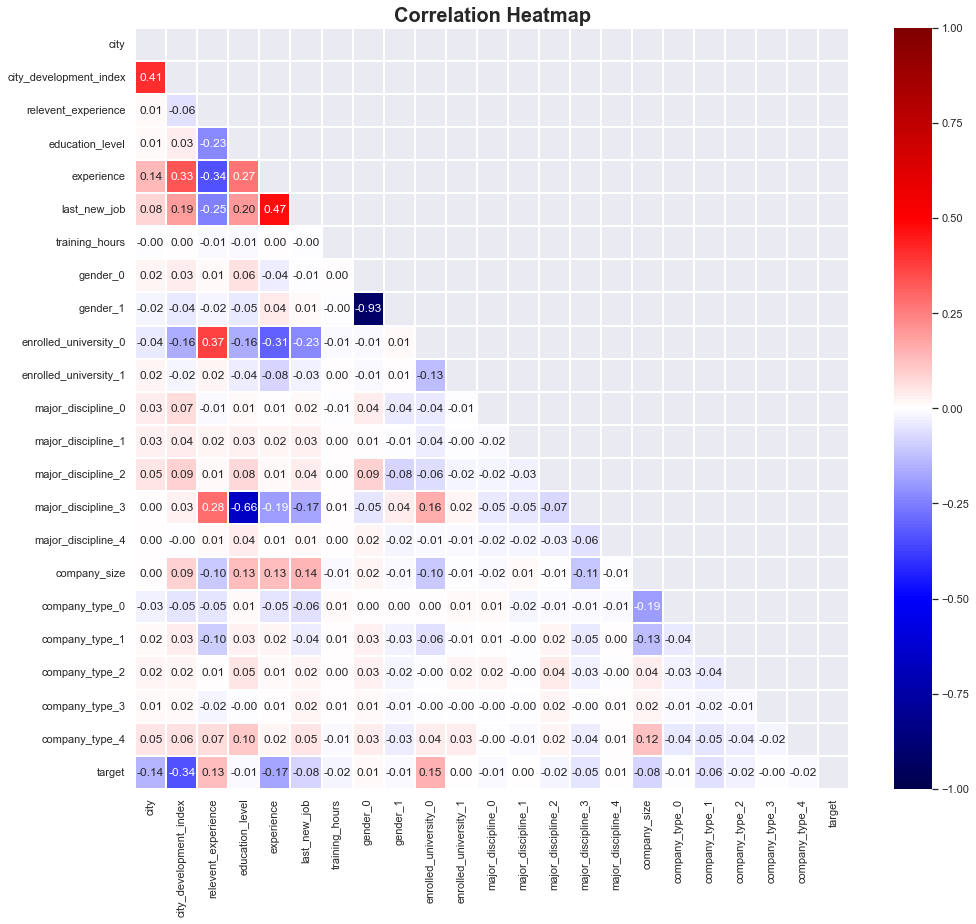

In [ ]:
corr = df.corr()
mask = np.triu(np.ones_like(corr, dtype=bool))
fig = plt.figure(figsize=[16,14])
sns.heatmap(corr,cmap='seismic',linewidth=1.5,linecolor='white',vmax = 1, vmin=-1,mask=mask, annot=True,fmt='0.2f')
plt.title('Correlation Heatmap', weight='bold',fontsize=20)

# 5 Data Models and Predictions

In [ ]:
recall_l = list()
f1_score_l = list()
accuracy_l = list()
precision_l = list()

In [ ]:
class Model:
    def __init__(self, model, model_name, X, y):
        self._model = model
        self._model_name = model_name
        self._X = X
        self._y = y
        self.calc()

    def calc(self):
        print("MODEL:", self._model_name)
        self.test_size_split()

    def test_size_split(self):
        print("\nSPLIT TYPE: holdout method")
        l = [0.20,0.25,0.33]
        for i in l:
            print("\n\nSPLIT Ratio:",i)
            self.train_test_split_holdout(test_size=i)
        print("\nSPLIT TYPE: random subsampling method")
        for i in l:
            print("\n\nSPLIT Ratio:",i)
            self.train_test_split_randomSubsampling(test_size=i)
        print("\nSPLIT TYPE: cross validation method")
        for i in l:
            print("\n\nSPLIT Ratio:",i)
            self.train_test_split_crossValidation(k=round(1/i))

    def train_test_split_holdout(self,test_size):
        self.X_train,self.X_test,self.y_train,self.y_test = train_test_split(self._X,self._y,random_state=None,test_size=test_size)
        self.balancing()

    def train_test_split_randomSubsampling(self,test_size):
        self.X_train,self.X_test,self.y_train,self.y_test = list(),list(),list(),list()
        n = random.randint(5,10)
        for _ in range(n):
            X_traint,X_testt,y_traint,y_testt = train_test_split(self._X,self._y,random_state=None,test_size=test_size)
            self.X_train.append(X_traint)
            self.X_test.append(X_testt)
            self.y_train.append(y_traint)
            self.y_test.append(y_testt)
        self.balancing(n)

    def train_test_split_crossValidation(self,k):
        self.X_train,self.X_test,self.y_train,self.y_test = list(),list(),list(),list()
        kf = StratifiedKFold(n_splits = k, shuffle = True)
        for train_index, test_index in kf.split(self._X,self._y):
            self.X_train.append(self._X[train_index])
            self.X_test.append(self._X[test_index])
            self.y_train.append(self._y[train_index])
            self.y_test.append(self._y[test_index])
        self.balancing(k)

    def balancing(self,n=0):
        print("\t\t\tBALANCING: None")
        self.imbalanced(n)
        print("\t\t\tBALANCING: SMOTE")
        self.smote_balanced(n)

    def imbalanced(self,n=0):
        self.model_eval(n)

    def smote_balanced(self,n):
        mice = SMOTE()
        if n==0:
            self.X_train,self.y_train = mice.fit_resample(self.X_train,self.y_train)
        else:
            for i in range(n):
                self.X_train[i],self.y_train[i] = mice.fit_resample(self.X_train[i],self.y_train[i])
        self.model_eval(n)

    def model_eval(self,n):
        if n==0:
            model = self._model()
            model.fit(self.X_train,self.y_train)
            self.y_pred = model.predict(self.X_test)
            self.accuracy = accuracy_score(self.y_test,self.y_pred)
            self.f1score = f1_score(self.y_test,self.y_pred)
            self.precision = precision_score(self.y_test,self.y_pred)
            self.recall = recall_score(self.y_test,self.y_pred)
            self.confusion_matrix = confusion_matrix(self.y_test,self.y_pred)
        else:
            self.y_pred = list()
            self.confusion_matrix = [[0,0],[0,0]]
            accuracy,f1score,precision,recall = list(),list(),list(),list()
            for i in range(n):
                model = self._model()
                model.fit(self.X_train[i],self.y_train[i])
                self.y_pred.append(model.predict(self.X_test[i]))
                accuracy.append(accuracy_score(self.y_test[i],self.y_pred[i]))
                f1score.append(f1_score(self.y_test[i],self.y_pred[i]))
                precision.append(precision_score(self.y_test[i],self.y_pred[i]))
                recall.append(recall_score(self.y_test[i],self.y_pred[i]))
                cm = confusion_matrix(self.y_test[i],self.y_pred[i])
                self.confusion_matrix = [[self.confusion_matrix[k][j] + cm[k][j]  for j in range(2)] for k in range(2)]
            self.accuracy = sum(accuracy)/n
            self.f1score = sum(f1score)/n
            self.precision = sum(precision)/n
            self.recall = sum(recall)/n
            self.confusion_matrix = [[round(self.confusion_matrix[k][j]/n)  for j in range(2)] for k in range(2)]
        print(f'accuracy:{self.accuracy}\t\t\tf1_score:{self.f1score}\nprecision:{self.precision}\t\t\trecall:{self.recall}')
        accuracy_l.append(self.accuracy)
        precision_l.append(self.precision)
        recall_l.append(self.recall)
        f1_score_l.append(self.f1score)
        self.metrics_plot()

    def metrics_plot(self):
        C = self.confusion_matrix
        plt.figure(figsize=(4,3))

        sns.set(font_scale=1)
        labels = [0,1]
        # representing A in heatmap format
        cmap1=sns.light_palette("orange")

        sns.heatmap(C, annot=True, cmap=cmap1, fmt=".1f", xticklabels=labels, yticklabels=labels,annot_kws={"size":14})
        plt.xlabel('Predicted Class')
        plt.ylabel('Original Class')
        plt.title("Confusion matrix")

        plt.show()

In [ ]:
X = df.iloc[:,:-1].values
y = df.iloc[:,-1].values

## 5.1 Decision tree

MODEL: decision tree

SPLIT TYPE: holdout method


SPLIT Ratio: 0.2
			BALANCING: None
accuracy:0.6988517745302714			f1_score:0.40698869475847893
precision:0.391304347826087			recall:0.42398286937901497


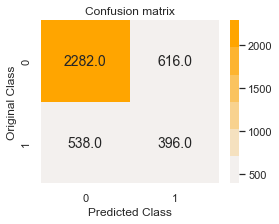

			BALANCING: SMOTE
accuracy:0.6931106471816284			f1_score:0.39754098360655743
precision:0.381139489194499			recall:0.41541755888650966


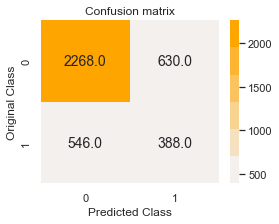



SPLIT Ratio: 0.25
			BALANCING: None
accuracy:0.7029227557411274			f1_score:0.415605749486653
precision:0.40512409927942356			recall:0.4266441821247892


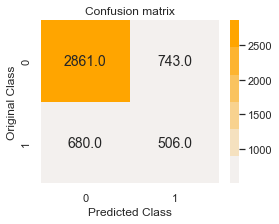

			BALANCING: SMOTE
accuracy:0.6895615866388309			f1_score:0.3987060250707642
precision:0.38306138306138304			recall:0.4156829679595278


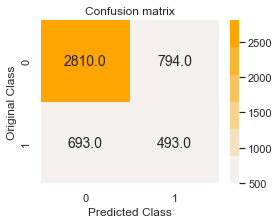



SPLIT Ratio: 0.33
			BALANCING: None
accuracy:0.7006167958247668			f1_score:0.415921012033323
precision:0.41147741147741146			recall:0.42046163443543355


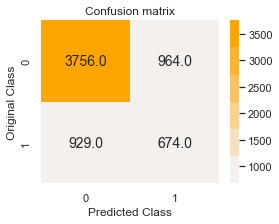

			BALANCING: SMOTE
accuracy:0.6885971848805946			f1_score:0.407106293285155
precision:0.39348079161816063			recall:0.4217092950717405


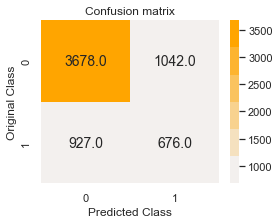


SPLIT TYPE: random subsampling method


SPLIT Ratio: 0.2
			BALANCING: None
accuracy:0.7053012227855652			f1_score:0.42440505122875877
precision:0.41562967668372697			recall:0.4339483171009353


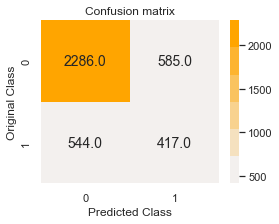

			BALANCING: SMOTE
accuracy:0.7014613778705636			f1_score:0.42111747994674725
precision:0.4099558996196291			recall:0.43342311519640625


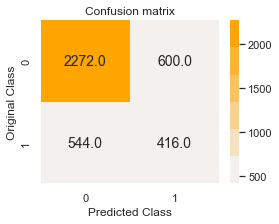



SPLIT Ratio: 0.25
			BALANCING: None
accuracy:0.6989352818371607			f1_score:0.41677448568998743
precision:0.4054612298650815			recall:0.4288925903906855


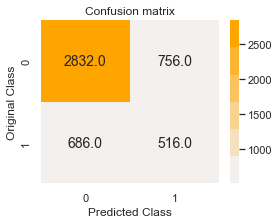

			BALANCING: SMOTE
accuracy:0.6983716075156574			f1_score:0.418307746053312
precision:0.4052446186690659			recall:0.43254193021509335


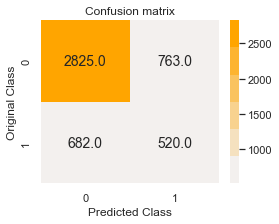



SPLIT Ratio: 0.33
			BALANCING: None
accuracy:0.702751858295113			f1_score:0.41931329377443155
precision:0.4091118497152996			recall:0.4301129481981674


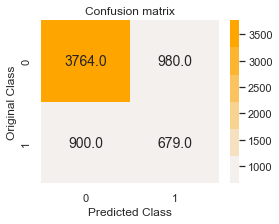

			BALANCING: SMOTE
accuracy:0.7006958722125572			f1_score:0.41693943939596995
precision:0.40575408709035937			recall:0.4289076240022664


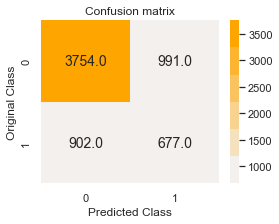


SPLIT TYPE: cross validation method


SPLIT Ratio: 0.2
			BALANCING: None
accuracy:0.70195261815897			f1_score:0.4238294409324145
precision:0.4090130799894552			recall:0.4398205875265614


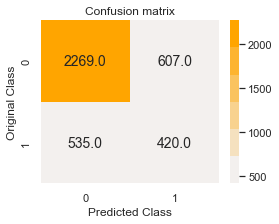

			BALANCING: SMOTE
accuracy:0.6994989234619894			f1_score:0.41418132637386096
precision:0.40292843455433475			recall:0.4262113080242721


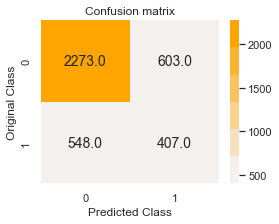



SPLIT Ratio: 0.25
			BALANCING: None
accuracy:0.7036747726936861			f1_score:0.423565053884004
precision:0.4110296818741558			recall:0.437092015166488


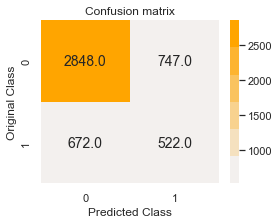

			BALANCING: SMOTE
accuracy:0.7003863455352406			f1_score:0.4222233538046346
precision:0.40660158003136615			recall:0.43918792007457086


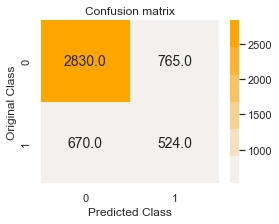



SPLIT Ratio: 0.33
			BALANCING: None
accuracy:0.7037269025994363			f1_score:0.4120475968653447
precision:0.4078811350272551			recall:0.41636882886918375


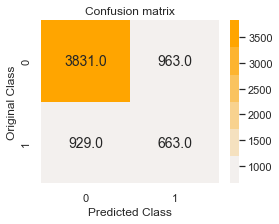

			BALANCING: SMOTE
accuracy:0.6960016703204928			f1_score:0.41635107702174096
precision:0.3993762484044787			recall:0.43499722929356976


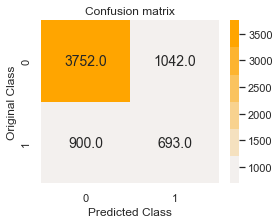

In [ ]:
Model(DecisionTreeClassifier,'decision tree', X,y)

## 5.2 Gaussian Naive Bayes

MODEL: Naive bayes

SPLIT TYPE: holdout method


SPLIT Ratio: 0.2
			BALANCING: None
accuracy:0.7225991649269311			f1_score:0.5252344796784278
precision:0.45901639344262296			recall:0.6137787056367432


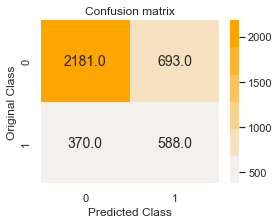

			BALANCING: SMOTE
accuracy:0.4921711899791232			f1_score:0.411373260738052
precision:0.28960817717206133			recall:0.7098121085594989


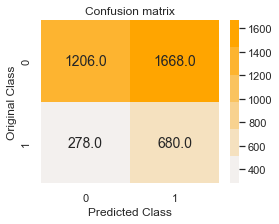



SPLIT Ratio: 0.25
			BALANCING: None
accuracy:0.7298538622129437			f1_score:0.5053516819571865
precision:0.4615921787709497			recall:0.558277027027027


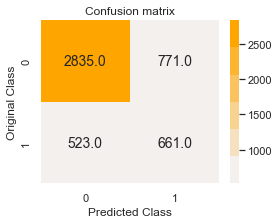

			BALANCING: SMOTE
accuracy:0.5104384133611691			f1_score:0.40737932777356584
precision:0.290659935088352			recall:0.6807432432432432


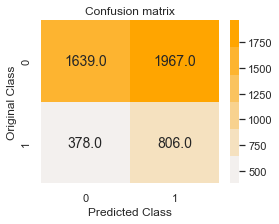



SPLIT Ratio: 0.33
			BALANCING: None
accuracy:0.7289261426538036			f1_score:0.5188096574957889
precision:0.4695121951219512			recall:0.5796737766624843


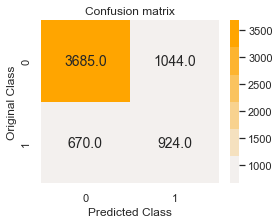

			BALANCING: SMOTE
accuracy:0.5416732563656492			f1_score:0.42431466030989273
precision:0.31046511627906975			recall:0.6700125470514429


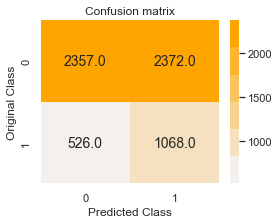


SPLIT TYPE: random subsampling method


SPLIT Ratio: 0.2
			BALANCING: None
accuracy:0.7211899791231733			f1_score:0.5075940207025832
precision:0.44992580867108634			recall:0.5826771154059978


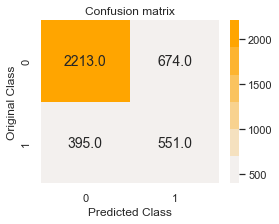

			BALANCING: SMOTE
accuracy:0.520902922755741			f1_score:0.42021749510349526
precision:0.2996268697209853			recall:0.7037194110840641


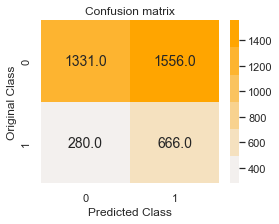



SPLIT Ratio: 0.25
			BALANCING: None
accuracy:0.7201345395499883			f1_score:0.5027944271715475
precision:0.45152732526204364			recall:0.5675088813577785


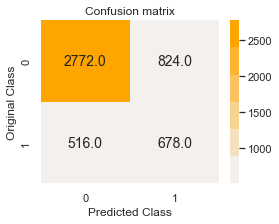

			BALANCING: SMOTE
accuracy:0.5160055671537926			f1_score:0.41855836417416364
precision:0.29874202258076477			recall:0.6990623517141682


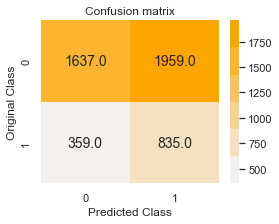



SPLIT Ratio: 0.33
			BALANCING: None
accuracy:0.7257947176972956			f1_score:0.5104225296736004
precision:0.4559830088983842			recall:0.5799310621701993


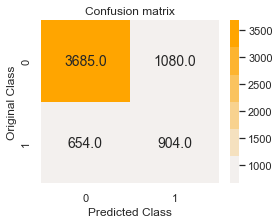

			BALANCING: SMOTE
accuracy:0.5226316621856714			f1_score:0.42160597066183525
precision:0.3006031275394074			recall:0.7059590679904959


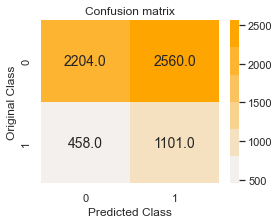


SPLIT TYPE: cross validation method


SPLIT Ratio: 0.2
			BALANCING: None
accuracy:0.7230399024767187			f1_score:0.5091653458998182
precision:0.45625186880250945			recall:0.576094328462836


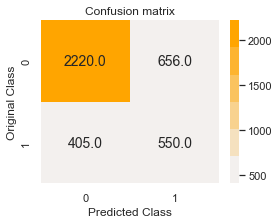

			BALANCING: SMOTE
accuracy:0.522811434463058			f1_score:0.420999877967511
precision:0.3019113777750512			recall:0.6954152336305286


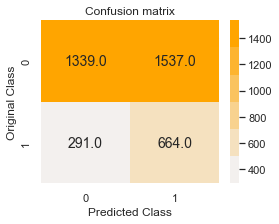



SPLIT Ratio: 0.25
			BALANCING: None
accuracy:0.7242927751532194			f1_score:0.5094145965611325
precision:0.45800763562077695			recall:0.5739967270102254


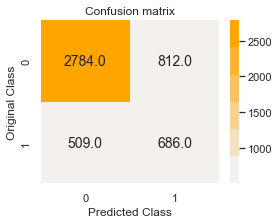

			BALANCING: SMOTE
accuracy:0.5214530101384915			f1_score:0.4197631097141872
precision:0.30085910832348917			recall:0.6941608320542743


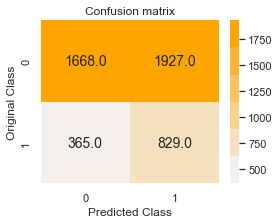



SPLIT Ratio: 0.33
			BALANCING: None
accuracy:0.7234575634199811			f1_score:0.5103996894599179
precision:0.4571491248074058			recall:0.5777656329355502


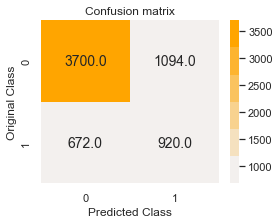

			BALANCING: SMOTE
accuracy:0.5295959912308175			f1_score:0.42528683736191364
precision:0.30579590466500356			recall:0.6981328488014461


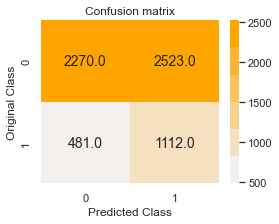

In [ ]:
Model(GaussianNB,'Naive bayes',X,y)

## 5.3 K-nearest Neighbors

MODEL: K-nearest neighbors

SPLIT TYPE: holdout method


SPLIT Ratio: 0.2
			BALANCING: None
accuracy:0.7377348643006263			f1_score:0.36352121595946807
precision:0.4584664536741214			recall:0.3011542497376705


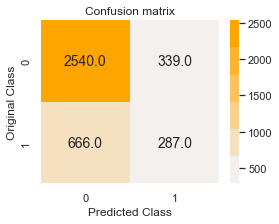

			BALANCING: SMOTE
accuracy:0.6244780793319415			f1_score:0.42737763629128533
precision:0.34423076923076923			recall:0.5634837355718783


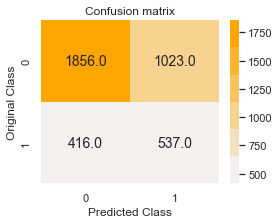



SPLIT Ratio: 0.25
			BALANCING: None
accuracy:0.7440501043841337			f1_score:0.3876123876123876
precision:0.49489795918367346			recall:0.3185550082101806


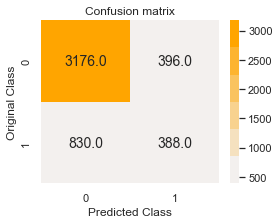

			BALANCING: SMOTE
accuracy:0.6206680584551149			f1_score:0.44654279622296683
precision:0.3549636803874092			recall:0.6018062397372742


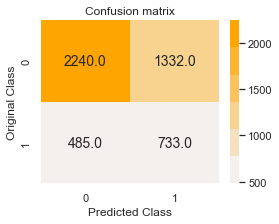



SPLIT Ratio: 0.33
			BALANCING: None
accuracy:0.7388897675154199			f1_score:0.3647556752597153
precision:0.47023809523809523			recall:0.29792583280955376


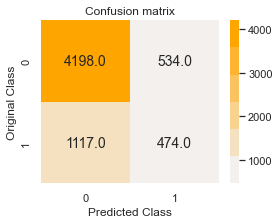

			BALANCING: SMOTE
accuracy:0.6201170330539301			f1_score:0.44191449814126393
precision:0.3505344636933284			recall:0.5977372721558768


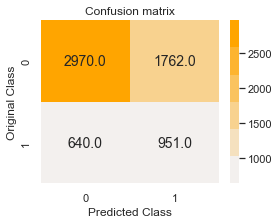


SPLIT TYPE: random subsampling method


SPLIT Ratio: 0.2
			BALANCING: None
accuracy:0.74491127348643			f1_score:0.3782699243990077
precision:0.4808034542988536			recall:0.3120447298007046


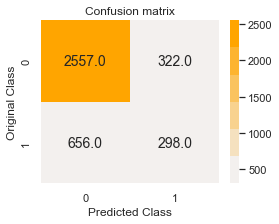

			BALANCING: SMOTE
accuracy:0.623695198329854			f1_score:0.44032773860685265
precision:0.34961118093596244			recall:0.5951347209233774


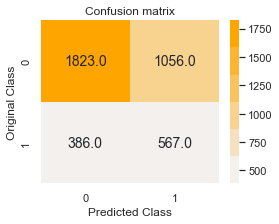



SPLIT Ratio: 0.25
			BALANCING: None
accuracy:0.7454816582165226			f1_score:0.3769354829729511
precision:0.47817956018656943			recall:0.31146720103393283


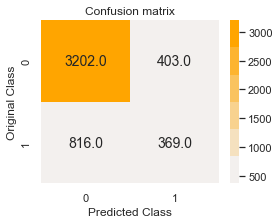

			BALANCING: SMOTE
accuracy:0.6295257977930211			f1_score:0.4439868272070479
precision:0.3531402387772606			recall:0.5983217940594099


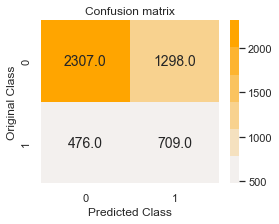



SPLIT Ratio: 0.33
			BALANCING: None
accuracy:0.739538193895303			f1_score:0.37395128856312365
precision:0.47470972525990457			recall:0.30864082910971413


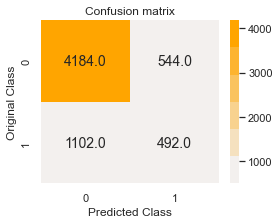

			BALANCING: SMOTE
accuracy:0.6255258579788074			f1_score:0.44278405051092645
precision:0.35437621314300244			recall:0.5901436069666554


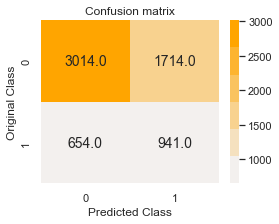


SPLIT TYPE: cross validation method


SPLIT Ratio: 0.2
			BALANCING: None
accuracy:0.741935637685969			f1_score:0.37110043945677607
precision:0.47288902581729947			recall:0.30542355801879556


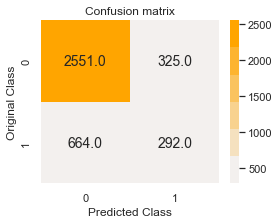

			BALANCING: SMOTE
accuracy:0.6260052320128782			f1_score:0.4421288749973883
precision:0.3520313222816762			recall:0.5943072137396219


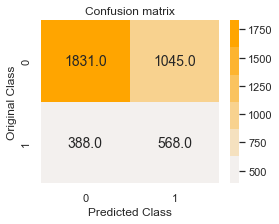



SPLIT Ratio: 0.25
			BALANCING: None
accuracy:0.7411529705993773			f1_score:0.37303552842362286
precision:0.4712510837231678			recall:0.30877469635485655


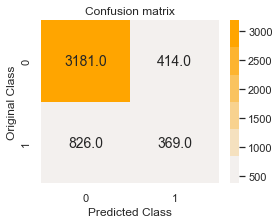

			BALANCING: SMOTE
accuracy:0.627153573930515			f1_score:0.4422956438676072
precision:0.3527484910420245			recall:0.5928419993972652


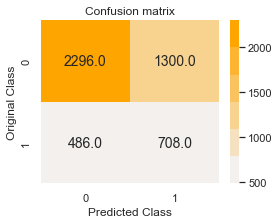



SPLIT Ratio: 0.33
			BALANCING: None
accuracy:0.7407349410168077			f1_score:0.37030400820507586
precision:0.469661279149046			recall:0.30583919808290244


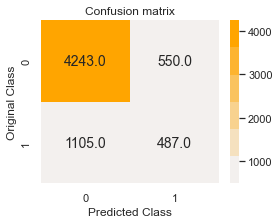

			BALANCING: SMOTE
accuracy:0.626265789748408			f1_score:0.44072447234607787
precision:0.35161674782651087			recall:0.5905386158665266


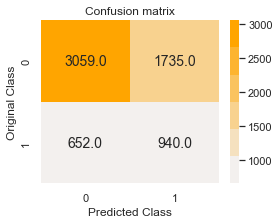

In [ ]:
Model(KNeighborsClassifier,'K-nearest neighbors',X,y)

In [ ]:
models = ['decision tree']*18+['naive bayes']*18+['k-nearest neighbors']*18
split_type = (['holdout']*6+ ['random subsampling']*6+ ['cross validation']*6)*3
test_size = (['0.2']*2+['0.25']*2+['0.33']*2)*9
oversampling = ['none','smote']*27


In [ ]:
metrics_df = pd.DataFrame({'models': models, 'split_type': split_type, 'test_size': test_size, 'oversampling':oversampling, 'accuracy':accuracy_l, 'f1 score':f1_score_l, 'precision':precision_l, 'recall':recall_l})

# 6 Results

In [ ]:
print("summary of metrics:")
metrics_df = metrics_df.set_index(['models','split_type','test_size','oversampling'])
pd.set_option('display.max_rows', None)
metrics_df

summary of metrics:


accuracy  \
models              split_type         test_size oversampling             
decision tree       holdout            0.2       none          0.698852   
                                                 smote         0.693111   
                                       0.25      none          0.702923   
                                                 smote         0.689562   
                                       0.33      none          0.700617   
                                                 smote         0.688597   
                    random subsampling 0.2       none          0.705301   
                                                 smote         0.701461   
                                       0.25      none          0.698935   
                                                 smote         0.698372   
                                       0.33      none          0.702752   
                                                 smote         0.700696   
                    cross validation   0.2       none          0.701953   
                                                 smote         0.699499   
                                       0.25      none          0.703675   
                                                 smote         0.700386   
                                       0.33      none          0.703727   
                                                 smote         0.696002   
naive bayes         holdout            0.2       none          0.722599   
                                                 smote         0.492171   
                                       0.25      none          0.729854   
                                                 smote         0.510438   
                                       0.33      none          0.728926   
                                                 smote         0.541673   
                    random subsampling 0.2       none          0.721190   
                                                 smote         0.520903   
                                       0.25      none          0.720135   
                                                 smote         0.516006   
                                       0.33      none          0.725795   
                                                 smote         0.522632   
                    cross validation   0.2       none          0.723040   
                                                 smote         0.522811   
                                       0.25      none          0.724293   
                                                 smote         0.521453   
                                       0.33      none          0.723458   
                                                 smote         0.529596   
k-nearest neighbors holdout            0.2       none          0.737735   
                                                 smote         0.624478   
                                       0.25      none          0.744050   
                                                 smote         0.620668   
                                       0.33      none          0.738890   
                                                 smote         0.620117   
                    random subsampling 0.2       none          0.744911   
                                                 smote         0.623695   
                                       0.25      none          0.745482   
                                                 smote         0.629526   
                                       0.33      none          0.739538   
                                                 smote         0.625526   
                    cross validation   0.2       none          0.741936   
                                                 smote         0.626005   
                                       0.25      none          0.741153   
                                                 smote         0.627154   
             

In [ ]:
max(accuracy_l)

0.7454816582165226

In [ ]:
max(f1_score_l)

0.5252344796784278

In [ ]:
metrics_df[metrics_df.index.get_level_values(0)=='decision tree']

accuracy  f1 score  \
models        split_type         test_size oversampling                       
decision tree holdout            0.2       none          0.698852  0.406989   
                                           smote         0.693111  0.397541   
                                 0.25      none          0.702923  0.415606   
                                           smote         0.689562  0.398706   
                                 0.33      none          0.700617  0.415921   
                                           smote         0.688597  0.407106   
              random subsampling 0.2       none          0.705301  0.424405   
                                           smote         0.701461  0.421117   
                                 0.25      none          0.698935  0.416774   
                                           smote         0.698372  0.418308   
                                 0.33      none          0.702752  0.419313   
                                           smote         0.700696  0.416939   
              cross validation   0.2       none          0.701953  0.423829   
                                           smote         0.699499  0.414181   
                                 0.25      none          0.703675  0.423565   
                                           smote         0.700386  0.422223   
                                 0.33      none          0.703727  0.412048   
                                           smote         0.696002  0.416351   

                                                         precision    recall  
models        split_type         test_size oversampling                       
decision tree holdout            0.2       none           0.391304  0.423983  
                                           smote          0.381139  0.415418  
                                 0.25      none           0.405124  0.426644  
                                           smote          0.383061  0.415683  
                                 0.33      none           0.411477  0.420462  
                                           smote          0.393481  0.421709  
              random subsampling 0.2       none           0.415630  0.433948  
                                           smote          0.409956  0.433423  
                                 0.25      none           0.405461  0.428893  
                                           smote          0.405245  0.432542  
                                 0.33      none           0.409112  0.430113  
                                           smote          0.405754  0.428908  
              cross validation   0.2       none           0.409013  0.439821  
                                           smote          0.402928  0.426211  
                                 0.25      none           0.411030  0.437092  
                                           smote          0.406602  0.439188  
                                 0.33      none           0.407881  0.416369  
                                           smote          0.399376  0.434997

In [ ]:
metrics_df[metrics_df.index.get_level_values(0)=='naive bayes']

accuracy  f1 score  \
models      split_type         test_size oversampling                       
naive bayes holdout            0.2       none          0.722599  0.525234   
                                         smote         0.492171  0.411373   
                               0.25      none          0.729854  0.505352   
                                         smote         0.510438  0.407379   
                               0.33      none          0.728926  0.518810   
                                         smote         0.541673  0.424315   
            random subsampling 0.2       none          0.721190  0.507594   
                                         smote         0.520903  0.420217   
                               0.25      none          0.720135  0.502794   
                                         smote         0.516006  0.418558   
                               0.33      none          0.725795  0.510423   
                                         smote         0.522632  0.421606   
            cross validation   0.2       none          0.723040  0.509165   
                                         smote         0.522811  0.421000   
                               0.25      none          0.724293  0.509415   
                                         smote         0.521453  0.419763   
                               0.33      none          0.723458  0.510400   
                                         smote         0.529596  0.425287   

                                                       precision    recall  
models      split_type         test_size oversampling                       
naive bayes holdout            0.2       none           0.459016  0.613779  
                                         smote          0.289608  0.709812  
                               0.25      none           0.461592  0.558277  
                                         smote          0.290660  0.680743  
                               0.33      none           0.469512  0.579674  
                                         smote          0.310465  0.670013  
            random subsampling 0.2       none           0.449926  0.582677  
                                         smote          0.299627  0.703719  
                               0.25      none           0.451527  0.567509  
                                         smote          0.298742  0.699062  
                               0.33      none           0.455983  0.579931  
                                         smote          0.300603  0.705959  
            cross validation   0.2       none           0.456252  0.576094  
                                         smote          0.301911  0.695415  
                               0.25      none           0.458008  0.573997  
                                         smote          0.300859  0.694161  
                               0.33      none           0.457149  0.577766  
                                         smote          0.305796  0.698133

In [ ]:
metrics_df[metrics_df.index.get_level_values(0)=='k-nearest neighbors']

accuracy  \
models              split_type         test_size oversampling             
k-nearest neighbors holdout            0.2       none          0.737735   
                                                 smote         0.624478   
                                       0.25      none          0.744050   
                                                 smote         0.620668   
                                       0.33      none          0.738890   
                                                 smote         0.620117   
                    random subsampling 0.2       none          0.744911   
                                                 smote         0.623695   
                                       0.25      none          0.745482   
                                                 smote         0.629526   
                                       0.33      none          0.739538   
                                                 smote         0.625526   
                    cross validation   0.2       none          0.741936   
                                                 smote         0.626005   
                                       0.25      none          0.741153   
                                                 smote         0.627154   
                                       0.33      none          0.740735   
                                                 smote         0.626266   

                                                               f1 score  \
models              split_type         test_size oversampling             
k-nearest neighbors holdout            0.2       none          0.363521   
                                                 smote         0.427378   
                                       0.25      none          0.387612   
                                                 smote         0.446543   
                                       0.33      none          0.364756   
                                                 smote         0.441914   
                    random subsampling 0.2       none          0.378270   
                                                 smote         0.440328   
                                       0.25      none          0.376935   
                                                 smote         0.443987   
                                       0.33      none          0.373951   
                                                 smote         0.442784   
                    cross validation   0.2       none          0.371100   
                                                 smote         0.442129   
                                       0.25      none          0.373036   
                                                 smote         0.442296   
                                       0.33      none          0.370304   
                                                 smote         0.440724   

                                                               precision  \
models              split_type         test_size oversampling              
k-nearest neighbors holdout            0.2       none           0.458466   
                                                 smote          0.344231   
                                       0.25      none           0.494898   
                                                 smote          0.354964   
                                       0.33      none           0.470238   
                                                 smote          0.350534   
                    random subsampling 0.2       none           0.480803   
                                                 smote          0.349611   
                                       0.25      none           0.478180   
                                                 smote          0.353140   
                                       0.33      none           0.474710   
                                                 smote          0.354376 

In [ ]:
metrics_df[metrics_df['accuracy']==max(metrics_df['accuracy'])]

,,,,accuracy,f1 score,precision,recall
models,split_type,test_size,oversampling,,,,
k-nearest neighbors,random subsampling,0.25,none,0.745482,0.376935,0.47818,0.311467


In [ ]:
metrics_df[metrics_df['f1 score']==max(metrics_df['f1 score'])]

,,,,accuracy,f1 score,precision,recall
models,split_type,test_size,oversampling,,,,
naive bayes,holdout,0.2,none,0.722599,0.525234,0.459016,0.613779


In [ ]:
metrics_df[metrics_df['recall']==max(metrics_df['recall'])]

,,,,accuracy,f1 score,precision,recall
models,split_type,test_size,oversampling,,,,
naive bayes,holdout,0.2,smote,0.492171,0.411373,0.289608,0.709812


In [ ]:
metrics_df[metrics_df['precision']==max(metrics_df['precision'])]

,,,,accuracy,f1 score,precision,recall
models,split_type,test_size,oversampling,,,,
k-nearest neighbors,holdout,0.25,none,0.74405,0.387612,0.494898,0.318555


In [ ]:
met = metrics_df.values

In [ ]:
l = list(map(lambda x: (x[0]+x[1])/2,met))

In [ ]:
l.index(max(l))

18

In [ ]:
metrics_df.iloc[18]

accuracy     0.722599
f1 score     0.525234
precision    0.459016
recall       0.613779
Name: (naive bayes, holdout, 0.2, none), dtype: float64